# Importing  costume U-Net Class
    Warnings stem from legacy support. (Suppressed FutureWarning and DeprecationWarning)
### U-Net Class checks for Tensorflow Version.
    If lower than 2.0 eager execution is forced.

In [1]:
import numpy as np
from time import time as t
a=t()
from UNET_adv import UNET

eager execution is activated. Tensorflow version is: 1


# Importing data as memory mapped arrays
    Data used in this example is already normalized between values of zero and one. If data is not preprocessed, it can be, by just adding a path string into the class constructor data and mask variable. This will use normal numpy arrays though.

In [2]:
data_01=np.memmap('C:\\Users\\Grka\\Desktop\\_Robustness_AI\\Images\\data_fromdisk.npy',
                  dtype='float32', 
                  mode='r+', shape=(2523, 256, 256, 3))#<- Natural Data
mask_01=np.memmap('C:\\Users\\Grka\\Desktop\\_Robustness_AI\\Masks\\mask_fromdisk.npy',
                  dtype='float32', 
                  mode='r+', shape=(2523, 256, 256, 6))#<- Natural Mask
data_labels=[np.load('C:\\Users\\Grka\\Desktop\\_Robustness_AI\\Images\\types.npy'),
             np.array(['Neoplastic cells', 'Inflammatory', 'Connective/Soft tissue cells', 'Dead Cells', 'Epithelial','Background'])]

# Class Constructor --> Data Split --> Model Initializor
    Class Constructor takes Data Target Labels and Model Dimensions
    fix_data splits data randomly into training validation and test set (uses fixed seed 42 for reproducibility)
    build_model takes learning rate and optional weights and generates procedural U-Net Semantic Classifier according to dimensions specified in class constructor (does depend on the target class shape and input shape as well as the min and max convolutional depth)

<class 'numpy.memmap'>
Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 256, 256, 64) 1792        input_1[0][0]                    
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 256, 256, 64) 36928       conv2d[0][0]                     
__________________________________________________________________________________________________
max_pooling2d (MaxPooling2D)    (None, 128, 128, 64) 0           conv2d_1[0][0]                   
_______________________________________________________________________

94/93 [==============================] - 66s 701ms/step - loss: 0.2949 - acc: 0.8729 - val_loss: 0.3221 - val_acc: 0.8718
Epoch 11/60
94/93 [==============================] - 66s 704ms/step - loss: 0.2829 - acc: 0.8772 - val_loss: 0.2864 - val_acc: 0.8813
Epoch 12/60
94/93 [==============================] - 67s 716ms/step - loss: 0.2774 - acc: 0.8791 - val_loss: 0.2882 - val_acc: 0.8817
Epoch 13/60
94/93 [==============================] - 66s 706ms/step - loss: 0.2746 - acc: 0.8800 - val_loss: 0.2850 - val_acc: 0.8813
Epoch 14/60
94/93 [==============================] - 67s 710ms/step - loss: 0.2697 - acc: 0.8819 - val_loss: 0.2861 - val_acc: 0.8811
Epoch 15/60
94/93 [==============================] - 66s 705ms/step - loss: 0.2614 - acc: 0.8846 - val_loss: 0.2890 - val_acc: 0.8807
Epoch 16/60
94/93 [==============================] - 64s 683ms/step - loss: 0.2505 - acc: 0.8882 - val_loss: 0.2663 - val_acc: 0.8880
Epoch 17/60
94/93 [==============================] - 62s 655ms/step - loss

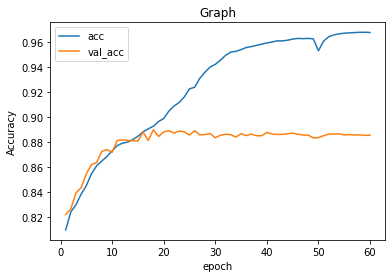

In [3]:
model_1=UNET(64,512,data=data_01,mask=mask_01,labels=data_labels).fix_data().build_model(lr=.0004,path='No')
model_1.train(60,18,False,draw=True)

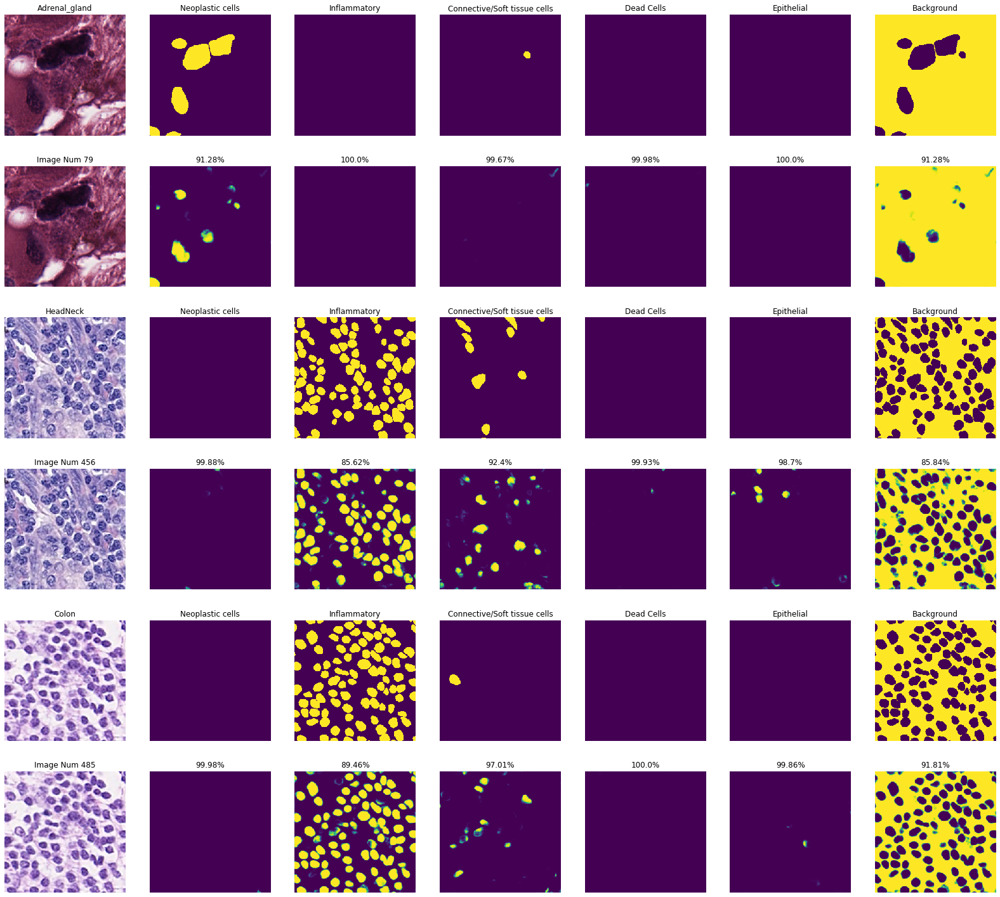

561/561 - 5s - loss: 0.6816 - acc: 0.8762


In [25]:
_=model_1.predict(size=3)

# Generating augmented training sets on bases of standard U-Net
    This code chunk takes the vanilla training data set and tries to reduce sensitivity for each class by compensating class features deemed useful by the model. This is an iterative process for the exp_data variable using targeted FGSM (fast gradient sign method) first taking background class into account. Every step takes 100 cycles to find most compensating perturbation added to the previous step.
    For the data variable it is a heuristic search which accounts for all possible combinations of perturbation and augmentations for each class to create a pattern that optimally influences classification in terms of accuracy.  

In [5]:
exp_data=model_1.train_data
for x in range(6):
    exp_data=model_1.distill_patterns(exp_data,model_1.train_mask,-1,.001,x,iterativ=True)

[||||||||||||||||||||] 100.0%
Done!
[||||||||||||||||||||] 100.0%
Done!
[||||||||||||||||||||] 100.0%
Done!
[||||||||||||||||||||] 100.0%
Done!
[||||||||||||||||||||] 100.0%
Done!
[||||||||||||||||||||] 100.0%
Done!


In [6]:
data=model_1.selectiv_(model_1.train_data,model_1.train_mask,.01)

[||||||||||||||||||||] 100.0%  
Done!


In [7]:
exp_pred=model_1.predict(exp_data,model_1.train_mask,draw=False)
pred=model_1.predict(data,model_1.train_mask,draw=False)

1682/1682 - 17s - loss: 6.3911 - acc: 0.0619
1682/1682 - 15s - loss: 0.0246 - acc: 0.9691


# Draw Predictions 
    Shows augmented vis-à-vis non augmented predictions. Augmented predictions seem to be less spread over classes and more certain on decision boundaries. Further tests are needed to confirm observation. Nonetheless overall accuracy drops.

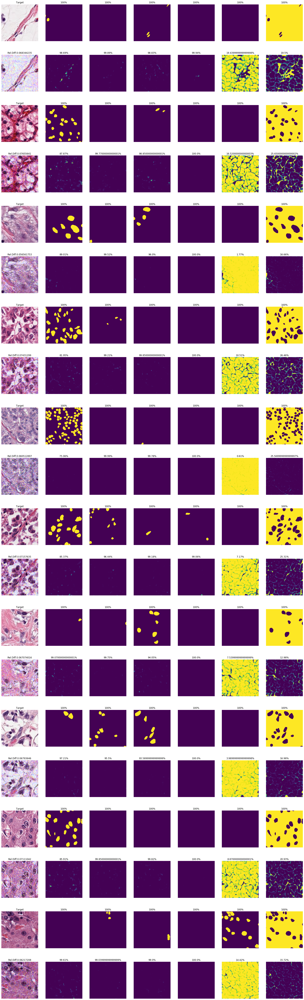

In [8]:
model_1.draw_random(model_1.train_data,exp_data,model_1.train_mask,exp_pred)

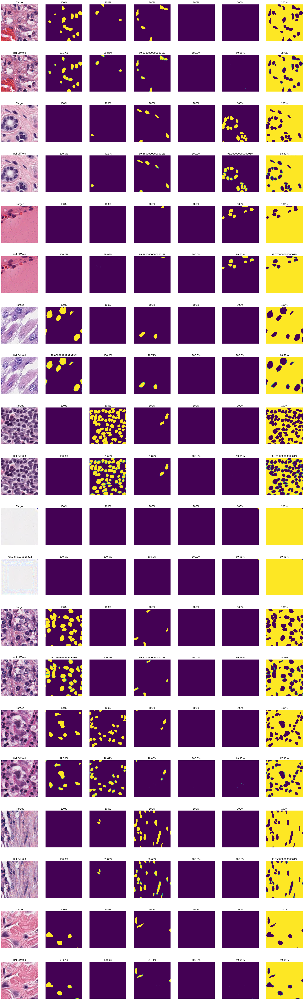

In [9]:
model_1.draw_random(model_1.train_data,data,model_1.train_mask,pred)

# Setting up a second and third model trained on augmented Data
    This code chunks produce a second and third similar neural network which are trained on a training set augmented by the previous model's distill_patterns and select_ methods. It is tested against the former test sets. As before random samples are drawn to show results. 

loaded
Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d_17 (Conv2D)              (None, 256, 256, 64) 1792        input_2[0][0]                    
__________________________________________________________________________________________________
conv2d_18 (Conv2D)              (None, 256, 256, 64) 36928       conv2d_17[0][0]                  
__________________________________________________________________________________________________
max_pooling2d_3 (MaxPooling2D)  (None, 128, 128, 64) 0           conv2d_18[0][0]                  
_____________________________________________________________________________________

94/93 [==============================] - 59s 624ms/step - loss: 0.3181 - acc: 0.8660 - val_loss: 0.3109 - val_acc: 0.8732
Epoch 14/60
94/93 [==============================] - 59s 625ms/step - loss: 0.3127 - acc: 0.8684 - val_loss: 0.3180 - val_acc: 0.8704
Epoch 15/60
94/93 [==============================] - 59s 625ms/step - loss: 0.3092 - acc: 0.8693 - val_loss: 0.3035 - val_acc: 0.8769
Epoch 16/60
94/93 [==============================] - 59s 625ms/step - loss: 0.2956 - acc: 0.8734 - val_loss: 0.3003 - val_acc: 0.8772
Epoch 17/60
94/93 [==============================] - 59s 625ms/step - loss: 0.2917 - acc: 0.8754 - val_loss: 0.2904 - val_acc: 0.8796
Epoch 18/60
94/93 [==============================] - 59s 625ms/step - loss: 0.2859 - acc: 0.8766 - val_loss: 0.2923 - val_acc: 0.8803
Epoch 19/60
94/93 [==============================] - 59s 625ms/step - loss: 0.2759 - acc: 0.8803 - val_loss: 0.2929 - val_acc: 0.8783
Epoch 20/60
94/93 [==============================] - 59s 625ms/step - loss

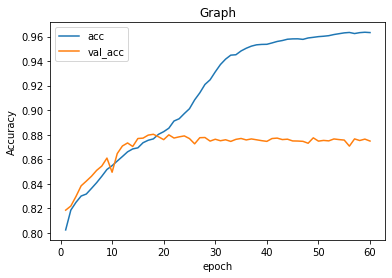

In [10]:
model_2=UNET(64,512).load_data(model_1.return_data()).build_model(lr=.0004,path='')
model_2.train(60,18,safe=False,data=exp_data,mask=model_1.train_mask,draw=True)

loaded
Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d_34 (Conv2D)              (None, 256, 256, 64) 1792        input_3[0][0]                    
__________________________________________________________________________________________________
conv2d_35 (Conv2D)              (None, 256, 256, 64) 36928       conv2d_34[0][0]                  
__________________________________________________________________________________________________
max_pooling2d_6 (MaxPooling2D)  (None, 128, 128, 64) 0           conv2d_35[0][0]                  
_____________________________________________________________________________________

94/93 [==============================] - 62s 664ms/step - loss: 0.2692 - acc: 0.8820 - val_loss: 0.2897 - val_acc: 0.8791
Epoch 14/60
94/93 [==============================] - 62s 660ms/step - loss: 0.2697 - acc: 0.8824 - val_loss: 0.2759 - val_acc: 0.8836
Epoch 15/60
94/93 [==============================] - 63s 675ms/step - loss: 0.2551 - acc: 0.8865 - val_loss: 0.2742 - val_acc: 0.8844
Epoch 16/60
94/93 [==============================] - 63s 673ms/step - loss: 0.2494 - acc: 0.8890 - val_loss: 0.2785 - val_acc: 0.8853
Epoch 17/60
94/93 [==============================] - 62s 665ms/step - loss: 0.2446 - acc: 0.8902 - val_loss: 0.2698 - val_acc: 0.8856
Epoch 18/60
94/93 [==============================] - 63s 675ms/step - loss: 0.2374 - acc: 0.8932 - val_loss: 0.2639 - val_acc: 0.8877
Epoch 19/60
94/93 [==============================] - 63s 674ms/step - loss: 0.2246 - acc: 0.8972 - val_loss: 0.2692 - val_acc: 0.8865
Epoch 20/60
94/93 [==============================] - 63s 670ms/step - loss

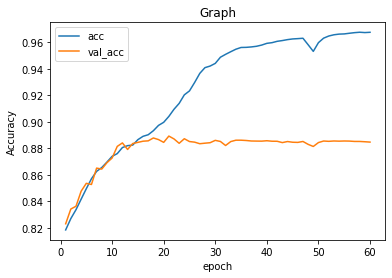

In [11]:
model_3=UNET(64,512).load_data(model_1.return_data()).build_model(lr=.0004,path='No')
model_3.train(60,18,safe=False,data=data,mask=model_1.train_mask,draw=True)

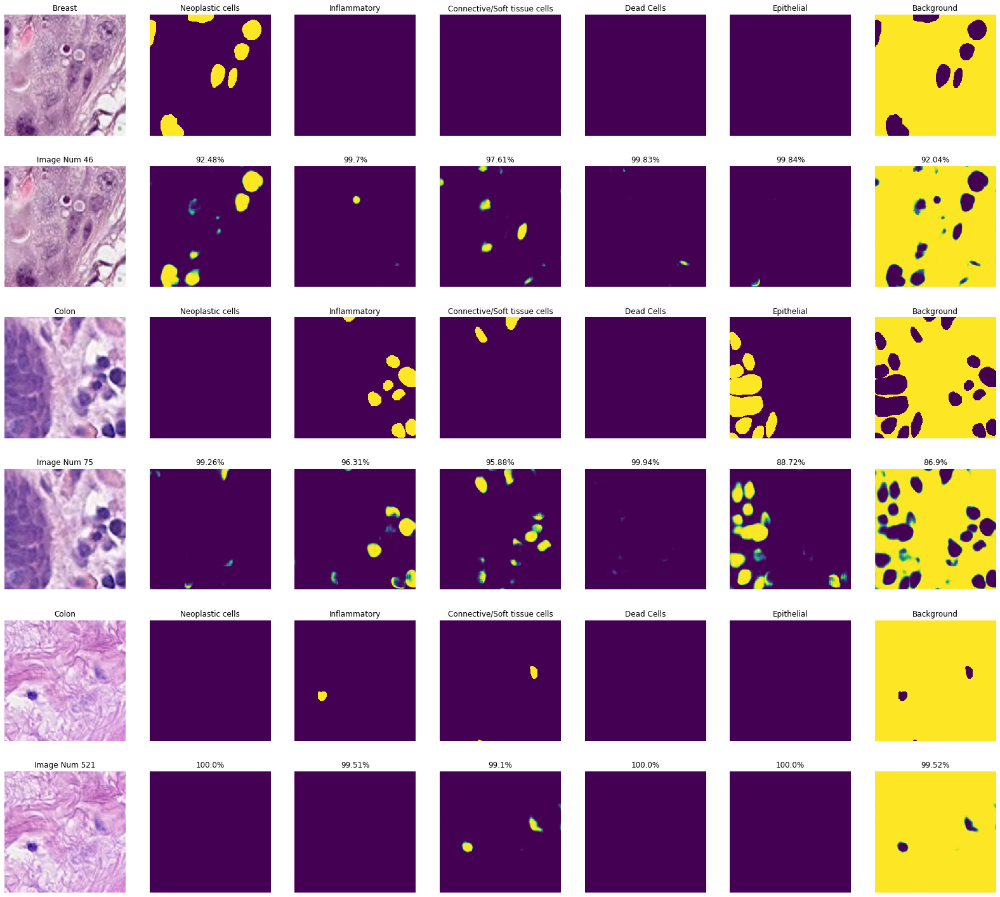

561/561 - 5s - loss: 0.7081 - acc: 0.8639


In [26]:
_=model_2.predict(size=3)

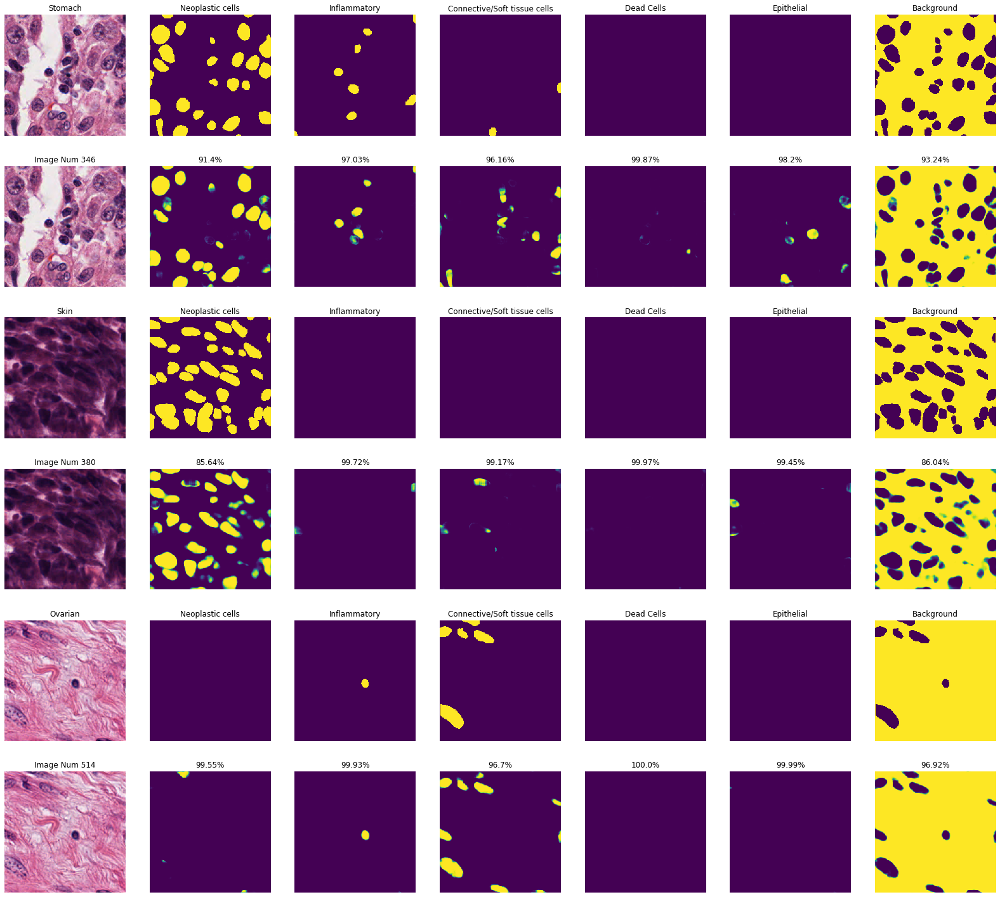

561/561 - 5s - loss: 0.6764 - acc: 0.8751


In [27]:
_=model_3.predict(size=3)

# Creating a Final Combined Dataset
Here the resulting datasets are combined to serve as training bases for a fourth Network. If our hypothesis is correct the final set should exhibit strong robustness as well as equivalent to better accuracy and loss.

In [14]:
fin_train_data=np.concatenate([data,model_1.train_data,exp_data],axis=0)
fin_train_mask=np.concatenate([model_1.train_mask,model_1.train_mask,model_1.train_mask],axis=0)

In [15]:
print(fin_train_data.shape,fin_train_mask.shape)

(5046, 256, 256, 3) (5046, 256, 256, 6)


# U-Net number 4
It is reduced in Epochs to compensate for the three times as big training set. This way results are more comparable.

loaded
Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d_51 (Conv2D)              (None, 256, 256, 64) 1792        input_4[0][0]                    
__________________________________________________________________________________________________
conv2d_52 (Conv2D)              (None, 256, 256, 64) 36928       conv2d_51[0][0]                  
__________________________________________________________________________________________________
max_pooling2d_9 (MaxPooling2D)  (None, 128, 128, 64) 0           conv2d_52[0][0]                  
_____________________________________________________________________________________

Epoch 13/20
281/280 [==============================] - 173s 617ms/step - loss: 0.0753 - acc: 0.9494 - val_loss: 0.4980 - val_acc: 0.8816
Epoch 14/20
281/280 [==============================] - 173s 615ms/step - loss: 0.0652 - acc: 0.9530 - val_loss: 0.5227 - val_acc: 0.8806
Epoch 15/20
281/280 [==============================] - 173s 616ms/step - loss: 0.0578 - acc: 0.9555 - val_loss: 0.5659 - val_acc: 0.8809
Epoch 16/20
281/280 [==============================] - 173s 615ms/step - loss: 0.0555 - acc: 0.9564 - val_loss: 0.5154 - val_acc: 0.8796
Epoch 17/20
281/280 [==============================] - 171s 609ms/step - loss: 0.0620 - acc: 0.9542 - val_loss: 0.5559 - val_acc: 0.8821
Epoch 18/20
281/280 [==============================] - 171s 609ms/step - loss: 0.0481 - acc: 0.9592 - val_loss: 0.6454 - val_acc: 0.8819
Epoch 19/20
281/280 [==============================] - 171s 607ms/step - loss: 0.0423 - acc: 0.9614 - val_loss: 0.6539 - val_acc: 0.8821
Epoch 20/20
281/280 [====================

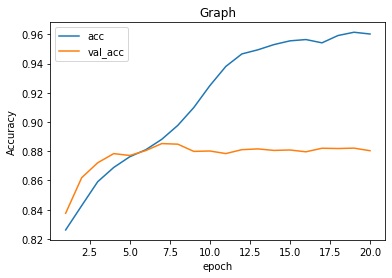

In [16]:
model_4=UNET(64,512).load_data(model_1.return_data()).build_model(lr=.0004,path='No')
model_4.train(20,18,safe=False,data=fin_train_data,mask=fin_train_mask,draw=True)

# Testing
First, we test against the test dataset. The final network shows equivalent performance. 
In training this network as all others in this notebook we observe a repeating pattern of loss rebounding. This may stem from the low quality of the data and class adherence. Standardization seems to be advisable. 

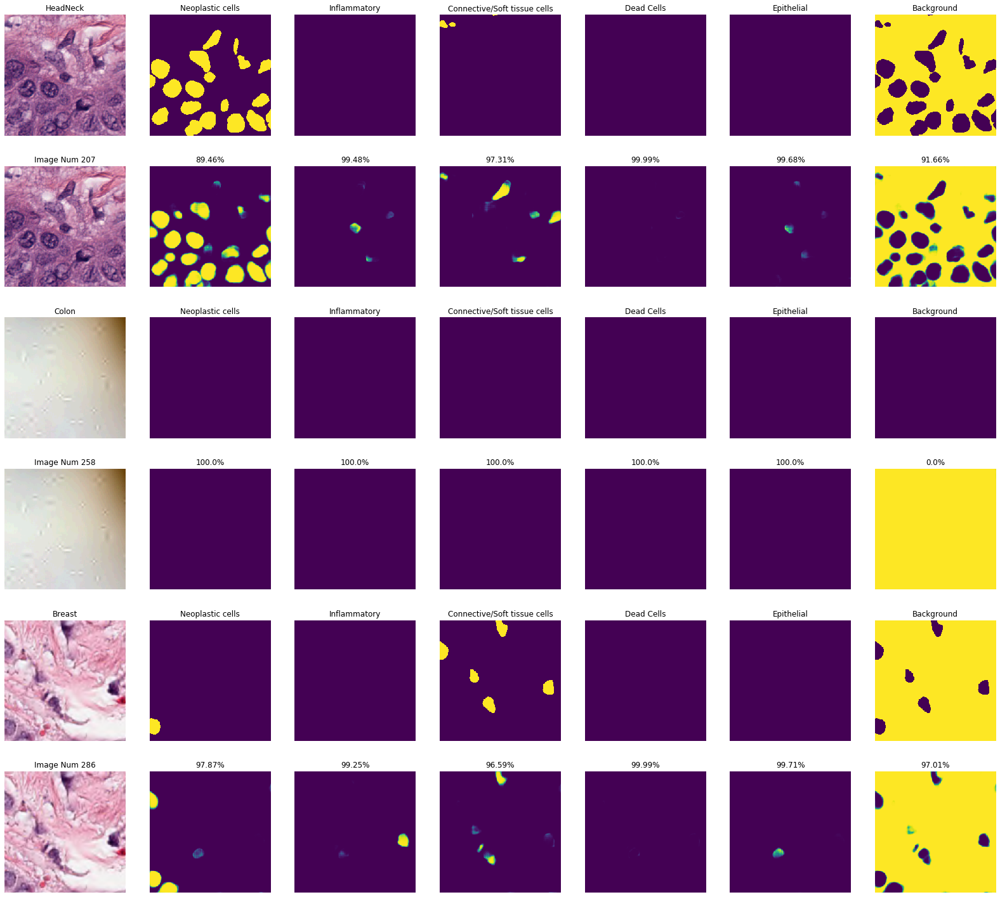

561/561 - 5s - loss: 0.5284 - acc: 0.8707


In [28]:
_=model_4.predict(size=3)

## Testing against perturbed Data
Here special focus shall lie on the distill_patterns method since it is designed to fool the network by forcing one class and therefore constitutes for a real adversarial attack while the select_ method is an augmentation to counter the effects of the adversarial training. As results show the network now is able to circumvent previously devastating attacks while sustaining equivalent prediction quality.
For good measure we added a plot of predictions the select_ method data produced at the end. There are no significant changes to prediction between model 1 and model 4.

### Testing against adversarial attack resulting in Background Class with adversarial training

[||||||||||||||||||||] 100.0%
Done!


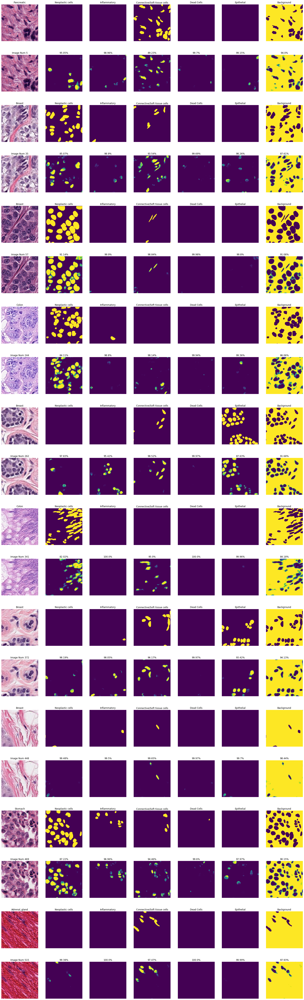

561/561 - 5s - loss: 0.5399 - acc: 0.8696


In [18]:
adv_data=model_1.distill_patterns(model_1.test_data,model_1.test_mask,-1,.001,6,iterativ=True)
adv_pred=model_4.predict(adv_data,model_1.test_mask,size=10)

### Testing against adversarial attack resulting in Background Class with no adversarial training
This class is chosen to illustrate effectiveness of the method because it is first in the adversarial process and therefore the most overlaid. 

561/561 - 5s - loss: 2.5053 - acc: 0.8087


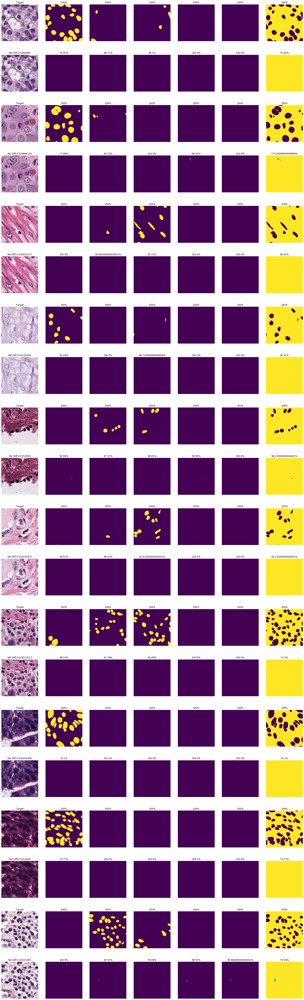

In [19]:
model_1.draw_random(model_1.test_data,adv_data,model_1.test_mask,model_1.predict(adv_data,model_1.test_mask,draw=False))

### Testing against augmented dataset

In [20]:
aug_data=model_4.selectiv_(model_1.test_data,model_1.test_mask,.01)

[||||||||||||||||||||] 100.0%  
Done!


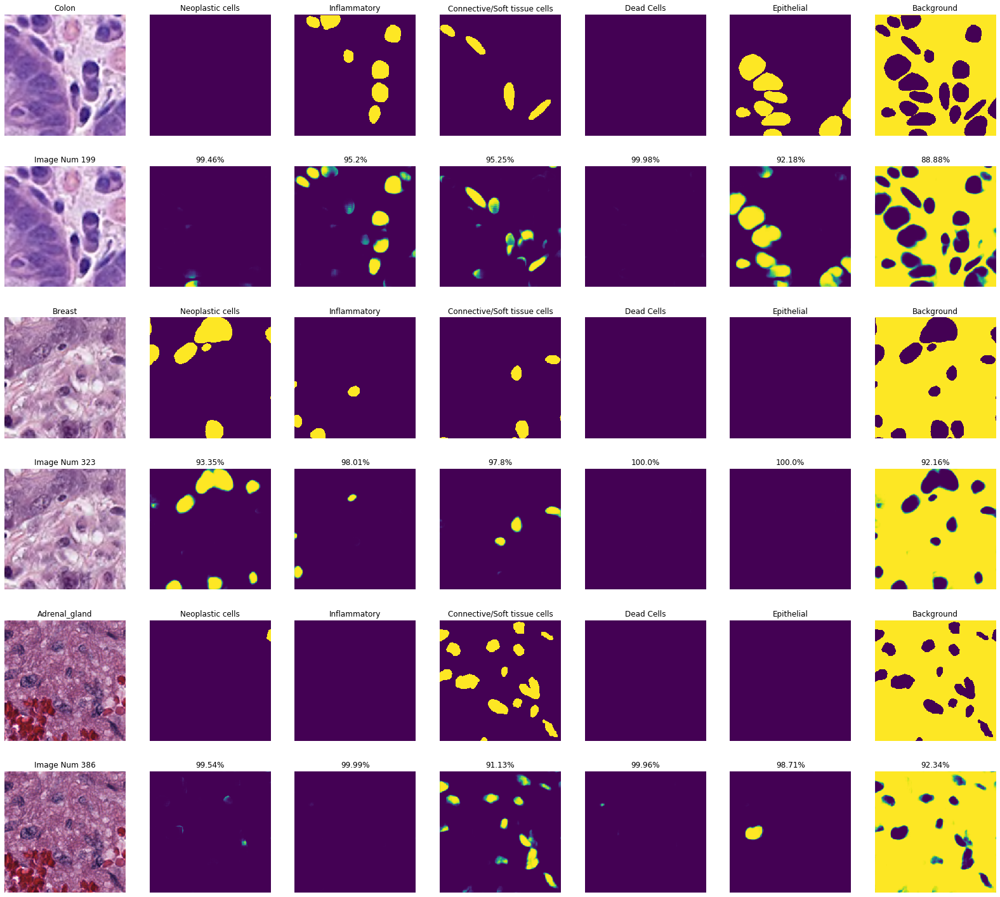

561/561 - 5s - loss: 0.4479 - acc: 0.8949


In [29]:
_=model_4.predict(aug_data,model_1.test_mask,size=3)

## Time
The whole setup took 31 hours 3 minutes and 51 seconds to complete on an intel i7 6core @ 4.1 Ghz with 32GB DDR3 RAM and a Geforce 1080 Ti with 11GB VRAM. Although unnecessary the training results of model 2 and model 3 can be used to compare effectiveness of combined training in both robustness and accuracy. 
As shown differences are not big but subtle. Model 4 with 20 Epochs of training shows 1% gain in accuracy on the standard test set vs. model 2 which was trained for 60 Epochs on the multiclass perturbed exp_data set.

In [22]:
time_to=(t()-a)/3600
time_h=np.floor(time_to)
time_m=np.floor((time_to-time_h)*60)
time_s=np.floor((time_to*60-np.floor(time_to*60))*60)
print('time:',int(time_h),'hours',int(time_m),'mins',int(time_s),'sec')

time: 31 hours 3 mins 51 sec


# Conclusion 
Adding the selectiv_ method to the training loop helped to increase precision but also prolonged training time exponentially. This makes it unfeasible for big datasets and limited compute power. Nonetheless it may be worth the effort in security sensitive segmentation tasks like histology or automated driving where error is not an option. Furthermore, the true potential of these technic is hard to predict without highly accurate datasets and stronger hardware. Therefore, we must remain inconclusive for the time, although resulting model 4 shows robustness against strong attacks that perturbe mean pixel values around 3 percent. A possible solution for the quality problem is synthetic datasets generated by algorithms like Kandinsky Patterns.


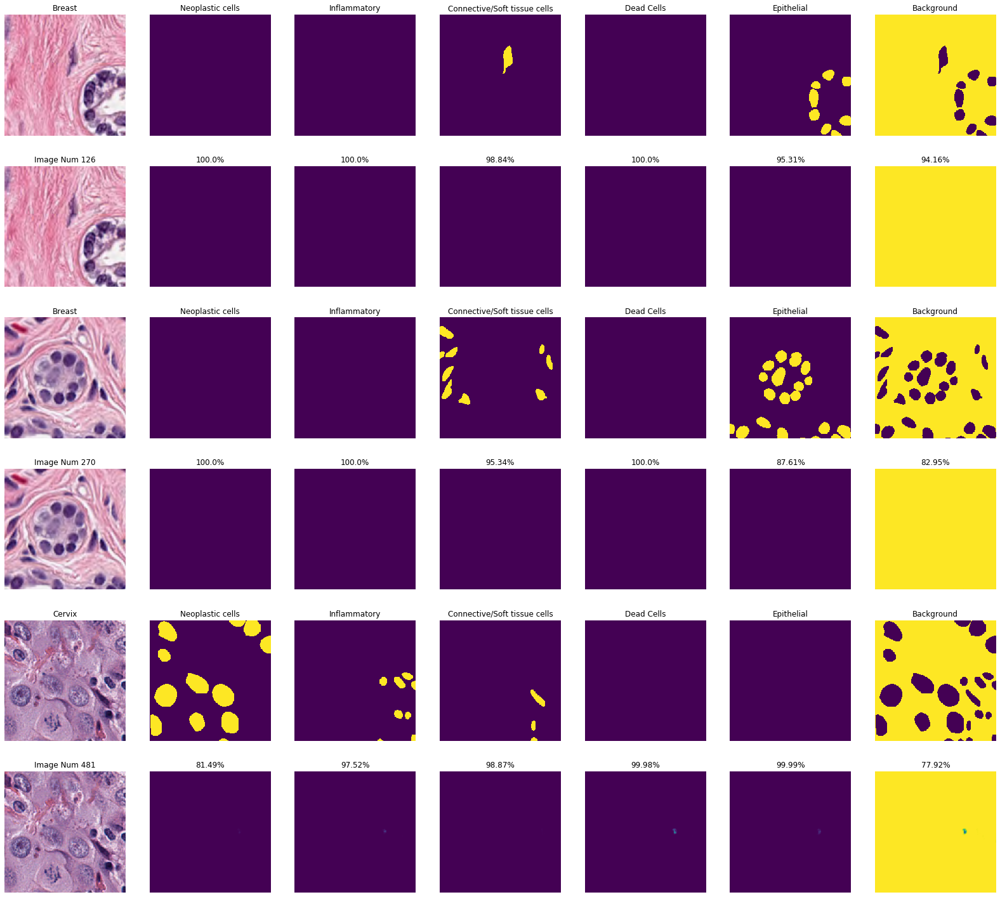

561/561 - 5s - loss: 2.5053 - acc: 0.8087


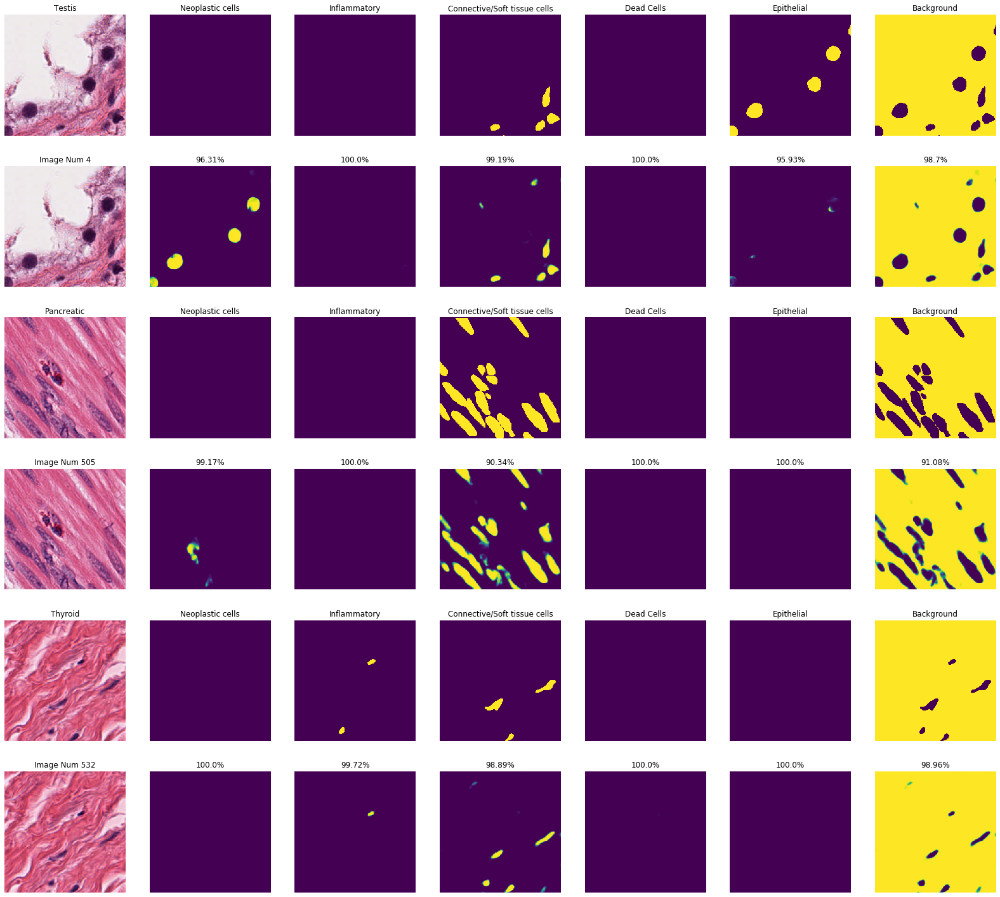

561/561 - 5s - loss: 0.7142 - acc: 0.8648


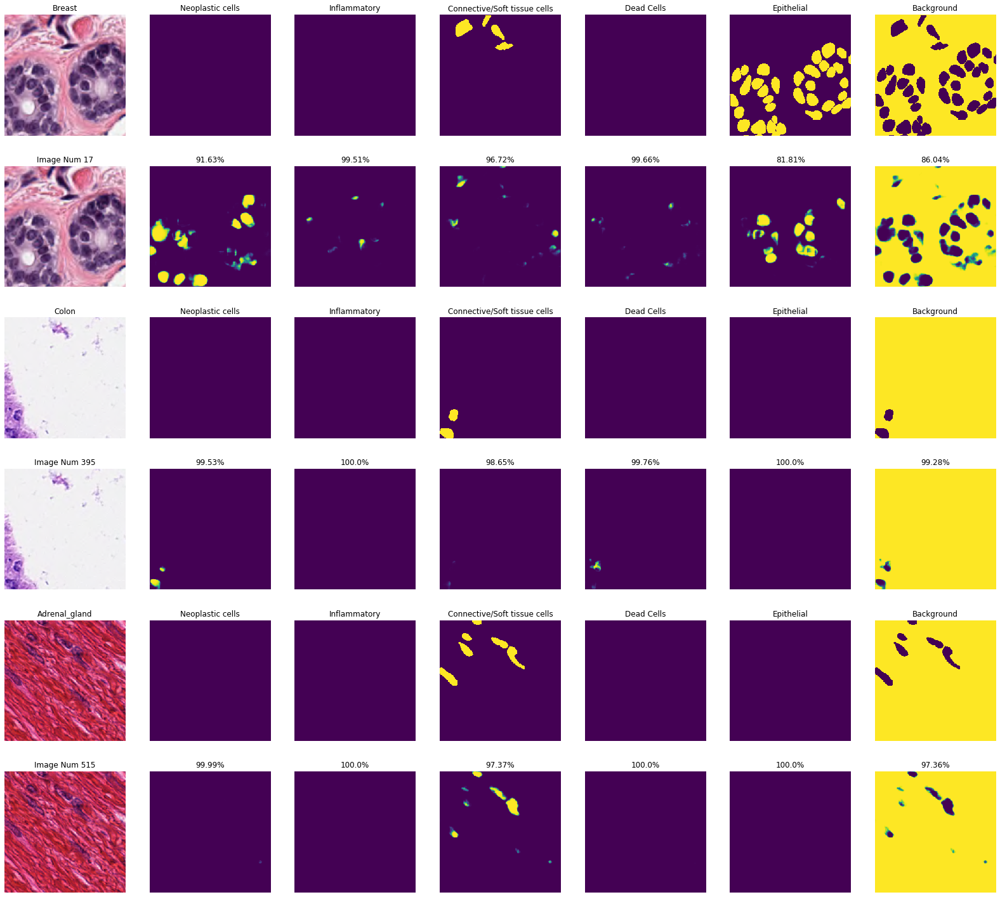

561/561 - 5s - loss: 1.2233 - acc: 0.8403


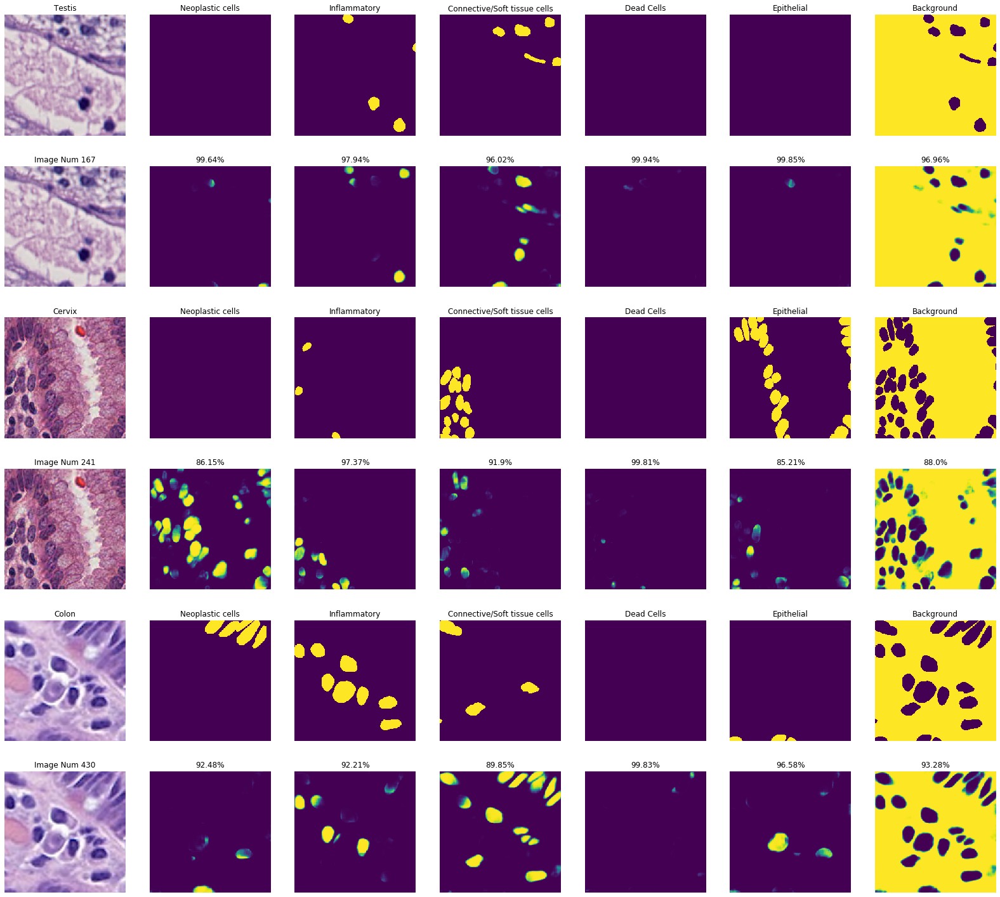

561/561 - 5s - loss: 0.5399 - acc: 0.8696


In [30]:
_=model_1.predict(adv_data,model_1.test_mask,size=3)
_=model_2.predict(adv_data,model_1.test_mask,size=3)
_=model_3.predict(adv_data,model_1.test_mask,size=3)
_=model_4.predict(adv_data,model_1.test_mask,size=3)

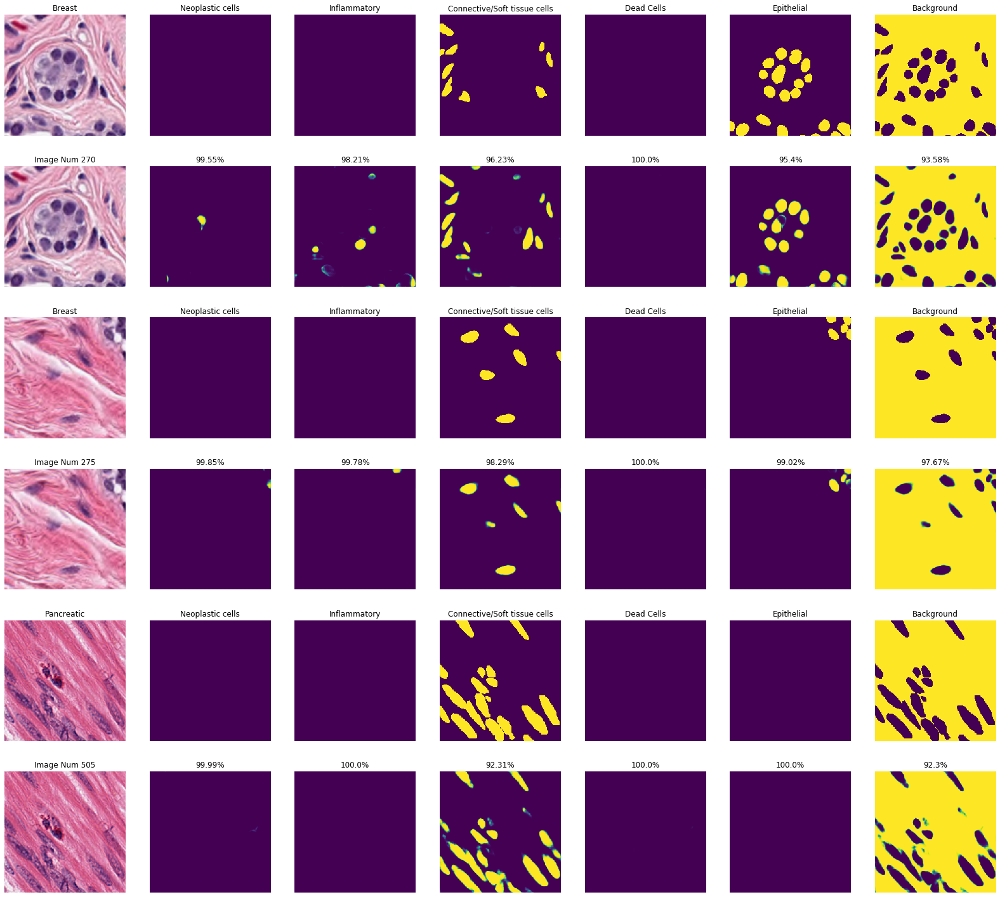

561/561 - 5s - loss: 0.6434 - acc: 0.8813


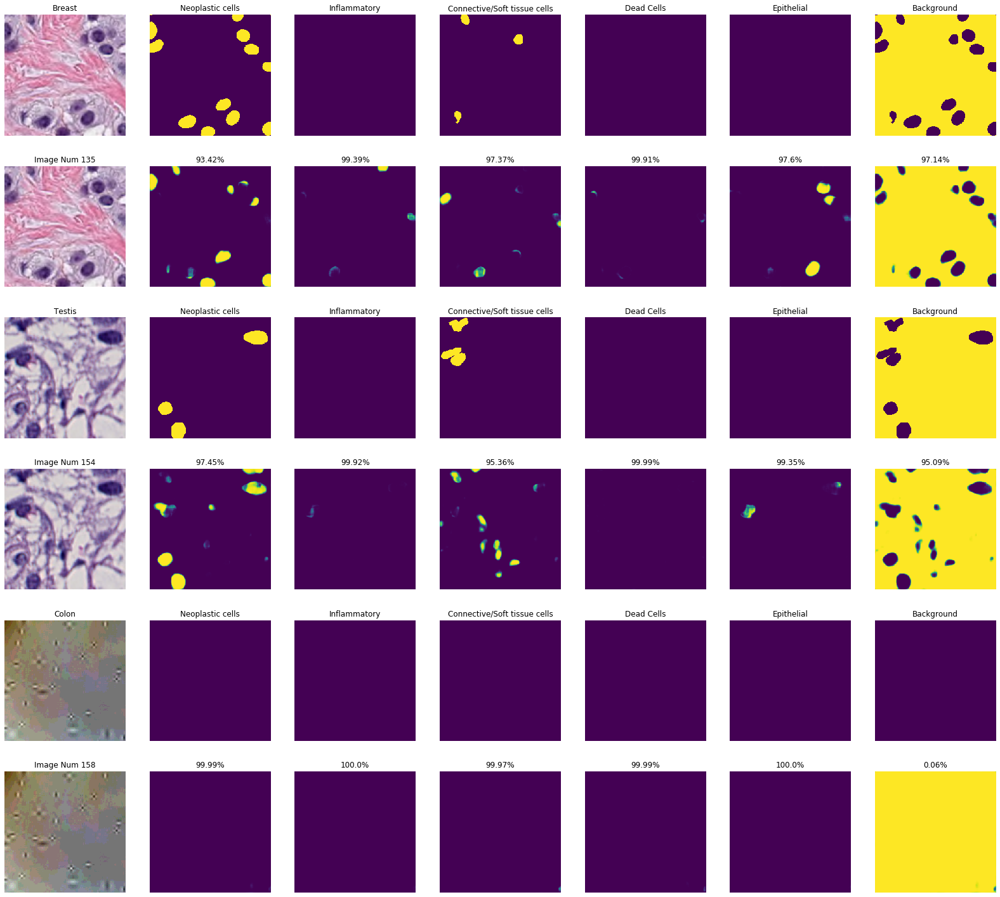

561/561 - 5s - loss: 0.6278 - acc: 0.8755


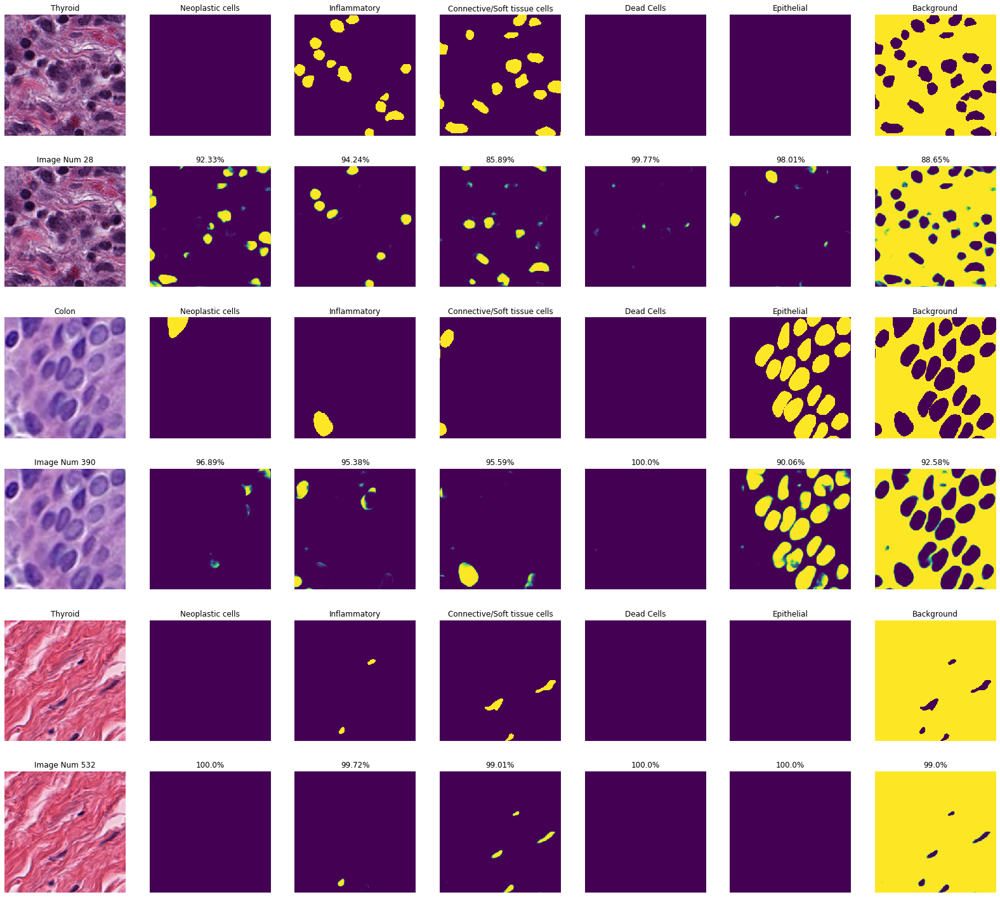

561/561 - 5s - loss: 0.6320 - acc: 0.8807


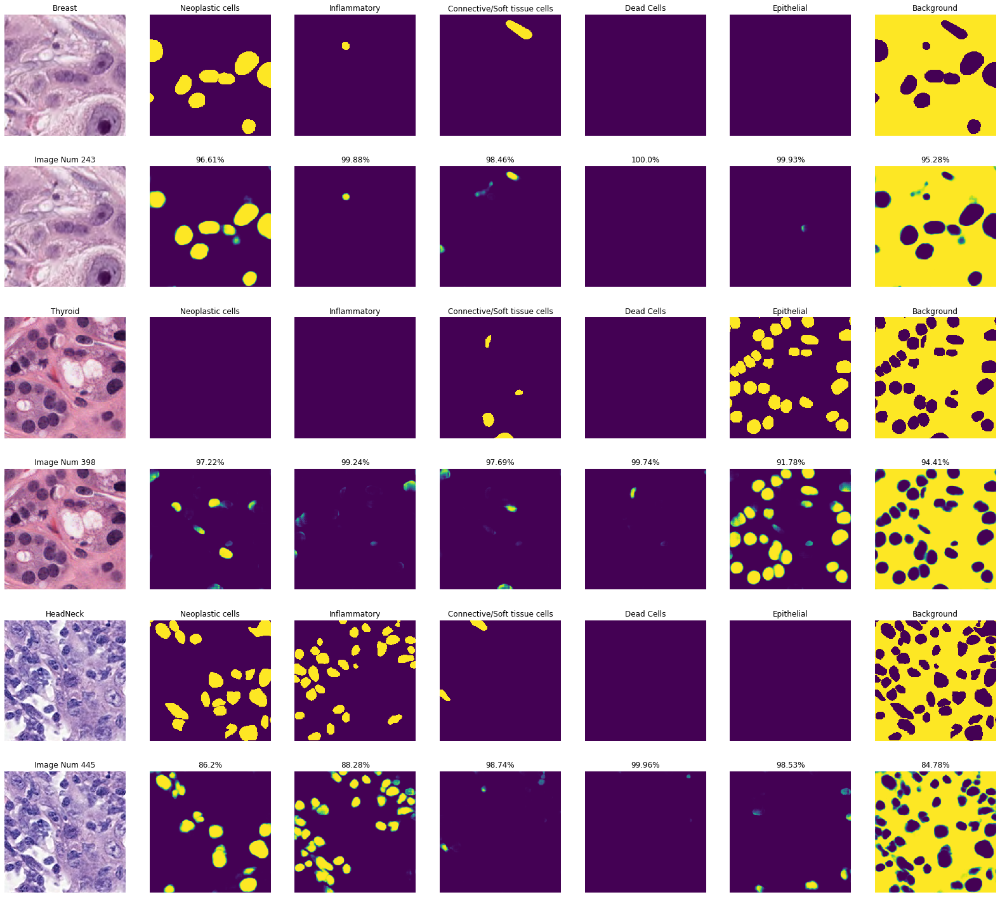

561/561 - 5s - loss: 0.4479 - acc: 0.8949


In [31]:
_=model_1.predict(aug_data,model_1.test_mask,size=3)
_=model_2.predict(aug_data,model_1.test_mask,size=3)
_=model_3.predict(aug_data,model_1.test_mask,size=3)
_=model_4.predict(aug_data,model_1.test_mask,size=3)